# <center>  $\color{indigo}{\text{Data Exploration and Analysis }}$ </center>

# <center>  $\color{indigo}{\text{ Analyzing Crime Trends in Omaha: A Data Exploration. }}$ </center>

## <center>  $\color{indigo}{\text{Bellevue University. }}$ </center>
## <center>  $\color{indigo}{\text{DSC 530 }}$ </center>
### <center>  $\color{indigo}{\text{Term Project. }}$ </center>

##### <center>  $\color{indigo}{\text{SAMUEL ABOYE }}$ </center>

### Overview 

As a resident of Nebraska, I feel a strong personal connection to the vibrant city of Omaha and am deeply invested in addressing one of the most significant issues facing our community: crime. To further this goal, I have undertaken a research project titled **Analyzing Crime Trends in Omaha: A Data Exploration.** My aim with this project is to delve into the complex landscape of criminal activity in our city in order to identify patterns and critical areas of concern, with the ultimate goal of using data analysis to shape effective policies and bolster public safety measures.

The core of this project is a commitment to using data as a powerful tool to drive positive change, supporting collective efforts to reduce crime and enhance community safety. My hope is that the insights gained through this research will contribute to ongoing discussions around crime reduction and offer a valuable, data-driven perspective that can inform the initiatives of law enforcement, civic leaders, and the broader Omaha community.

To me, this work is more than just an academic exercise - it is a civic duty and a meaningful way to contribute to the safety and well-being of my fellow Nebraskans. I believe that by harnessing the power of data analysis, we can work together to create a safer, more secure Omaha that shines as a beacon of community resilience and safety in the Midwest.

### Data

The data is collected from this [website](https://police.cityofomaha.org/crime-information/crime-statistics.) provided as a courtesy to the public by the Omaha Police Department. It is important to note that the department assumes no liability for actions based on the information displayed on the site. When reviewing the crime data, it is advisable to consider that areas with high foot or vehicle traffic or dense population may have more reported crimes than other areas. This does not necessarily mean that more crime occurs there, but that more crime is reported there. Additionally, the information does not reflect "safe" or "unsafe" areas within Omaha. It is also important to note that the data reflects only a snapshot in time, as the files used by OPD to compile crime statistics are dynamic and allow continuous data entry, which could result in additions, deletions, and/or modifications at any time. You can find more information about this on https://police.cityofomaha.org/crime-information/crime-statistics.

### 1. Selecting Variables

| Variable                       | Description                                                    |
|:--------------------------------|--------------------------------------------------------------:|
|RB Number                       |A unique identifier for the report.                             |
|Reported Date                   |The date when the incident was reported.                        |
|Reported Time                   |The time when the incident was reported.                        |
|Statute/Ordinance Description   |Description of the offense based on the statute or ordinance.   |
|Occurred Location               |The location where the incident occurred.                       |
|Occurred District               |The district where the incident occurred.                       |
|Occurred Block LAT              |Latitude of the block where the incident occurred.              |
|Occurred Block LON              |Longitude of the block where the incident occurred.             |
|Generalized Category            |A generalized category of the offense.                          |
|Year                            |The year when the incident occurred.                            |
|Season                          |The season when the incident occurred.                          |
|DayOfWeek                       |The day of the week when the incident occurred, encoded.        |
|DayOfWeekName                   |The name of the day of the week when the incident occurred.     |
|IsWeekend                       |A boolean indicating whether the incident occurred on a weekend.|


For my analysis, I could focus on the following five variables, considering their potential impact on the statistical question you might have:

For your analysis, we could focus on the following five variables, considering their potential impact on the statistical question you might have:

- Generalized Category: To explore the types of incidents.
- Occurred District: To analyze geographical distribution.
- Season: To investigate seasonal trends.
- DayOfWeekName: To see on which days incidents are more likely to happen.
- IsWeekend: To examine if incidents are more frequent during weekends.

These variables allow us to explore various aspects of the incidents reported, such as temporal trends, geographical patterns, and the nature of incidents.



 #### Importing the liberary 

In [1]:
import folium
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import statsmodels.api as sm
from collections import Counter
from scipy import stats
from scipy.stats import ttest_ind, cumfreq, poisson
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
from plotnine import ggplot, aes, geom_bar, theme, element_text, labs, scale_fill_manual
from plotnine import scale_x_discrete,geom_histogram, coord_flip, position_dodge
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
%matplotlib inline

#### Load the Crime CSV data to the DataFrame

In [2]:
data = pd.read_csv('./data/data.csv')

#### Check the dimensions of the DataFrame

In [3]:
data.shape

(424467, 14)

#### Prints a concise summary of the DataFrame

In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 424467 entries, 0 to 424466
Data columns (total 14 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   RB Number                      424467 non-null  object 
 1   Reported Date                  424467 non-null  object 
 2   Reported Time                  424467 non-null  object 
 3   Statute/Ordinance Description  424467 non-null  object 
 4   Occurred Location              424266 non-null  object 
 5   Occurred District              424467 non-null  int64  
 6   Occurred Block LAT             424467 non-null  float64
 7   Occurred Block LON             424467 non-null  float64
 8   Generalized Category           424467 non-null  object 
 9   Year                           424467 non-null  int64  
 10  Season                         424467 non-null  object 
 11  DayOfWeek                      424467 non-null  int64  
 12  DayOfWeekName                 

#### Missing Values Analysis

In [5]:
missing_values = data.isnull().sum()
print(missing_values)

RB Number                          0
Reported Date                      0
Reported Time                      0
Statute/Ordinance Description      0
Occurred Location                201
Occurred District                  0
Occurred Block LAT                 0
Occurred Block LON                 0
Generalized Category               0
Year                               0
Season                             0
DayOfWeek                          0
DayOfWeekName                      0
IsWeekend                          0
dtype: int64


#### Remove rows from the DataFrame where 'Occurred Location' column has missing values.

In [6]:
data = data.dropna(subset=['Occurred Location'])

#### Prints a concise summary of the DataFrame after remove the missing values

In [7]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 424266 entries, 0 to 424466
Data columns (total 14 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   RB Number                      424266 non-null  object 
 1   Reported Date                  424266 non-null  object 
 2   Reported Time                  424266 non-null  object 
 3   Statute/Ordinance Description  424266 non-null  object 
 4   Occurred Location              424266 non-null  object 
 5   Occurred District              424266 non-null  int64  
 6   Occurred Block LAT             424266 non-null  float64
 7   Occurred Block LON             424266 non-null  float64
 8   Generalized Category           424266 non-null  object 
 9   Year                           424266 non-null  int64  
 10  Season                         424266 non-null  object 
 11  DayOfWeek                      424266 non-null  int64  
 12  DayOfWeekName                  4242

#### Remove `Statute/Ordinance Description` it's the same with `Generalized Category`

In [8]:
data = data.drop(columns=['Statute/Ordinance Description'])

#### Convert `Reported Time` and the other Column to datetime format

In [9]:
data['Reported Time'] = pd.to_datetime(data['Reported Time'], format='%H:%M:%S').dt.time
data['Hour'] = data['Reported Time'].apply(lambda x: x.hour)
data['Reported Date'] = pd.to_datetime(data['Reported Date'])
data['Year'] = data['Reported Date'].dt.year

#### Descriptive Statistics for numerical variables

In [10]:
numerical_columns = ['Year', 'Hour']
descriptive_stats_numerical = data[numerical_columns].describe()
print(descriptive_stats_numerical)

                Year           Hour
count  424266.000000  424266.000000
mean     2019.326790      12.996441
std         2.471608       5.953429
min      2015.000000       0.000000
25%      2017.000000       9.000000
50%      2019.000000      13.000000
75%      2022.000000      18.000000
max      2023.000000      23.000000


In [11]:
data.head()

,RB Number,Reported Date,Reported Time,Occurred Location,Occurred District,Occurred Block LAT,Occurred Block LON,Generalized Category,Year,Season,DayOfWeek,DayOfWeekName,IsWeekend,Hour
0,AH33823,2015-02-11,17:00:20,3600 VINTON ST,62,41.229331,-95.966287,SEXUAL OFFENSES,2015,WINTER,2,WEDNESDAY,False,17
1,AH95364,2015-04-06,12:00:50,3800 REDICK AVE,31,41.317632,-95.969763,ASSAULT - MISDEMEANOR,2015,SPRING,0,MONDAY,False,12
2,AH01901,2015-05-14,10:00:32,3100 N 111TH PLZ,13,41.286776,-96.084376,CHILD ABUSE,2015,SPRING,3,THURSDAY,False,10
3,AH04804,2015-05-15,11:00:00,5700 S 29TH ST,67,41.200953,-95.956119,SEXUAL OFFENSES,2015,SPRING,4,FRIDAY,False,11
4,AH00018,2015-06-21,13:52:00,8100 CORBY ST,17,41.284222,-96.039285,CRIMINAL MISCHIEF/PROPERTY DAMAGE,2015,SUMMER,6,SUNDAY,True,13


In [12]:
data.tail()

,RB Number,Reported Date,Reported Time,Occurred Location,Occurred District,Occurred Block LAT,Occurred Block LON,Generalized Category,Year,Season,DayOfWeek,DayOfWeekName,IsWeekend,Hour
424462,AT53505,2023-12-31,23:53:00,700 N 14TH ST,51,41.265895,-95.934540,DRUG-RELATED,2023,WINTER,6,SUNDAY,True,23
424463,AT53506,2023-12-31,23:56:00,600 S 22ND ST,52,41.254080,-95.944828,MISSING/LOST PROPERTY,2023,WINTER,6,SUNDAY,True,23
424464,AT53509,2023-12-31,23:21:00,1100 HARNEY ST,51,41.256580,-95.930644,ASSAULT,2023,WINTER,6,SUNDAY,True,23
424465,AT53510,2023-12-31,22:47:00,600 S 13TH ST,51,41.254368,-95.933318,TRESPASSING,2023,WINTER,6,SUNDAY,True,22
424466,AT54138,2023-12-31,15:40:17,15000 WEST DODGE RD,106,41.263222,-96.148574,THEFT,2023,WINTER,6,SUNDAY,True,15


#### Descriptive Statistics Interpretation

The dataset consists of 424,266 reported incidents, providing a substantial sample size for analysis. 

#### Year
- **Mean (Average)**: On average, the incidents in the dataset occurred in the year 2019. This indicates that the data spans recent years up to 2023.
- **Standard Deviation**: With a standard deviation of approximately 2.47, the years when incidents were reported are relatively close to the mean year (2019), suggesting that the data points are not spread too widely over time.
- **Minimum**: The earliest reported incidents in the dataset are from the year 2015.
- **25th Percentile**: At least 25% of the incidents were reported by the year 2017, indicating that a quarter of the data is from the early period of the dataset.
- **Median (50th Percentile)**: The median year of incident reports is 2019, which means half of the incidents were reported on or before 2019, and the other half after.
- **75th Percentile**: Three-quarters of the incidents were reported by 2022, indicating that most incidents in the dataset are quite recent.
- **Maximum**: The most recent reported incidents in the dataset are from the year 2023.

#### Hour
- **Mean (Average)**: On average, incidents were reported around 13:00 (1 PM). This may suggest a tendency for incidents to be reported around early afternoon.
- **Standard Deviation**: The standard deviation for the hour of incident reports is approximately 5.95, indicating a moderate spread of report times throughout the day.
- **Minimum**: Incidents have been reported at all hours, starting from 0:00 (midnight).
- **25th Percentile**: 25% of incidents were reported by 9:00 AM, suggesting that a significant number of incidents tend to be reported in the morning.
- **Median (50th Percentile)**: The median report time is 13:00 (1 PM), which implies that half of the incidents were reported by early afternoon.
- **75th Percentile**: By 18:00 (6 PM), 75% of the incidents had been reported, which might indicate that fewer incidents are reported in the late evening.
- **Maximum**: Incidents have been reported as late as 23:00 (11 PM).

Convert value counts to a DataFrame and print in Markdown table format

In [13]:
categorical_columns = ['Generalized Category', 'Occurred District', 'Season', 'DayOfWeekName']

# Use a loop to print out each categorical column's value counts as a markdown table
for col in categorical_columns:
    # Get the value counts and reset the index to turn it into a DataFrame
    value_counts_df = data[col].value_counts().reset_index()
   
    value_counts_df.columns = [col, 'Count']
    # Convert the DataFrame to a markdown table string
    markdown_table = value_counts_df.to_markdown(index=False)
    ##Print the column name and its markdown table
#     print(f"#### {col} Value Counts\n")
#     print(markdown_table + "\n")

#### Generalized Category Value Counts

| Generalized Category              |   Count |
|:----------------------------------|--------:|
| THEFT                             |  148265 |
| CRIMINAL MISCHIEF/PROPERTY DAMAGE |   66351 |
| OTHER                             |   36418 |
| ASSAULT - MISDEMEANOR             |   34573 |
| THEFT - SHOPLIFTING               |   28556 |
| ASSAULT                           |   20062 |
| THREATS/TERRORISTIC ACTS          |   11248 |
| TRESPASSING                       |   10607 |
| CHILD ABUSE                       |   10084 |
| HARASSMENT/STALKING               |    9821 |
| MISSING/LOST PROPERTY             |    9412 |
| FRAUD                             |    8677 |
| ASSAULT - FELONY                  |    6449 |
| HOMICIDE/DEATH RELATED            |    6059 |
| SEXUAL OFFENSES                   |    5267 |
| DRUG-RELATED                      |    4571 |
| DOMESTIC VIOLENCE                 |    3973 |
| DISTURBING THE PEACE              |    1702 |
| UNAUTHORIZED USE OF PROPERTY      |    1403 |
| ARSON                             |     785 |
| KIDNAPPING                        |     113 |
| CONTRIBUTING TO DELINQUENCY       |      71 |

#### Occurred District Value Counts

|   Occurred District |   Count |
|--------------------:|--------:|
|                 998 |   12265 |
|                  51 |   12048 |
|                  12 |   10007 |
|                  13 |    8975 |
|                  26 |    8768 |
|                  65 |    7830 |
|                  14 |    7698 |
|                  29 |    7679 |
|                  15 |    7317 |
|                  16 |    7291 |
|                  48 |    7229 |
|                  84 |    6500 |
|                  64 |    6472 |
|                  74 |    6442 |
|                  17 |    6399 |
|                  79 |    6324 |
|                  45 |    6226 |
|                  71 |    6174 |
|                  22 |    6155 |
|                  87 |    6084 |
|                  38 |    6002 |
|                  21 |    5989 |
|                  63 |    5954 |
|                  32 |    5884 |
|                  11 |    5850 |
|                  66 |    5539 |
|                  34 |    5454 |
|                  72 |    5426 |
|                  76 |    5413 |
|                 101 |    5402 |
|                  35 |    5392 |
|                  89 |    5355 |
|                  23 |    5343 |
|                  61 |    5217 |
|                  27 |    5193 |
|                  52 |    5095 |
|                  28 |    5088 |
|                  62 |    4994 |
|                  75 |    4980 |
|                  33 |    4889 |
|                  78 |    4882 |
|                 102 |    4815 |
|                  88 |    4766 |
|                  68 |    4697 |
|                  67 |    4681 |
|                  24 |    4606 |
|                  53 |    4601 |
|                  54 |    4467 |
|                  18 |    4425 |
|                  73 |    4352 |
|                  36 |    4349 |
|                  47 |    4269 |
|                  43 |    4221 |
|                  19 |    4064 |
|                  83 |    3965 |
|                  31 |    3908 |
|                  56 |    3887 |
|                  25 |    3875 |
|                  41 |    3791 |
|                  44 |    3778 |
|                  37 |    3766 |
|                  46 |    3665 |
|                  39 |    3629 |
|                  85 |    3595 |
|                  77 |    3567 |
|                  55 |    3510 |
|                  81 |    3470 |
|                  86 |    3460 |
|                 103 |    3427 |
|                  82 |    3391 |
|                  91 |    3371 |
|                 105 |    3239 |
|                  42 |    3140 |
|                  96 |    3008 |
|                  92 |    2988 |
|                  49 |    2983 |
|                  59 |    2866 |
|                  97 |    2854 |
|                  94 |    2649 |
|                  57 |    2586 |
|                  95 |    2385 |
|                  93 |    2160 |
|                  58 |    1862 |
|                 107 |    1507 |
|                 104 |    1381 |
|                 106 |     936 |
|                 999 |     328 |
|                9998 |       1 |
|                  10 |       1 |
|                  98 |       1 |

#### Season Value Counts

| Season   |   Count |
|:---------|--------:|
| SUMMER   |  117413 |
| FALL     |  114738 |
| SPRING   |   98967 |
| WINTER   |   93349 |

#### DayOfWeekName Value Counts

| DayOfWeekName   |   Count |
|:----------------|--------:|
| WEDNESDAY       |   66284 |
| MONDAY          |   63544 |
| TUESDAY         |   62666 |
| THURSDAY        |   60414 |
| FRIDAY          |   59274 |
| SUNDAY          |   56237 |
| SATURDAY        |   56048 |



### Categorical Statistical Analysis

The dataset contains a comprehensive breakdown of incidents categorized by type, district, season, and the day of the week. The following statistics offer insights into the frequency of each category.

#### Generalized Category and the Crime value Counts

The `Generalized Category` gives us an overview of the types of incidents reported:

- **Theft** is the most commonly reported incident, with 148,265 cases.
- **Criminal Mischief/Property Damage** is the second most frequent, with 66,351 cases.
- Categories such as **Assault - Misdemeanor** and **Theft - Shoplifting** are also significant, with 34,573 and 28,556 cases respectively.
- Other serious incidents like **Child Abuse**, **Threats/Terroristic Acts**, and **Sexual Offenses** have been reported 10,084, 11,248, and 5,267 times respectively.

#### Occurred District and the Crime value Counts

Incident reports are also categorized by the `Occurred District`, highlighting the number of incidents in each police district:

- District 998 has the highest number of reports with 12,265 incidents, suggesting a hotspot for reporting.
- Other districts with high incident counts include 51, 12, and 13, with over 8,975 reports each.
- The spread of reports across districts indicates that some areas have higher incident rates, which may correlate with factors such as population density or police presence.

#### Season and the Crime value Counts

The `Season` in which incidents are reported can reveal seasonal trends:

- **Summer** sees the highest number of incidents with 117,413 reports, possibly due to increased outdoor activity.
- **Fall** follows closely with 114,738 reports.
- **Spring** and **Winter** have fewer incidents, with 98,967 and 93,349 reports respectively, which may be attributed to weather conditions and social behavior patterns during these seasons.

### Day Of Week and the Crime value Counts

The `DayOfWeekName` offers insights into which days of the week incidents are most frequently reported:

- **Wednesday** leads with 66,284 reports, closely followed by **Monday** and **Tuesday** with over 62,000 reports each.
- The weekend, including **Saturday** and **Sunday**, has slightly fewer reports compared to weekdays, with 56,048 and 56,237 reports respectively.

This analysis provides a clear picture of when and where incidents are most commonly reported, which can be crucial for law enforcement resource planning and community safety initiatives.


**For `Generalized Category` counts plot Histogram**

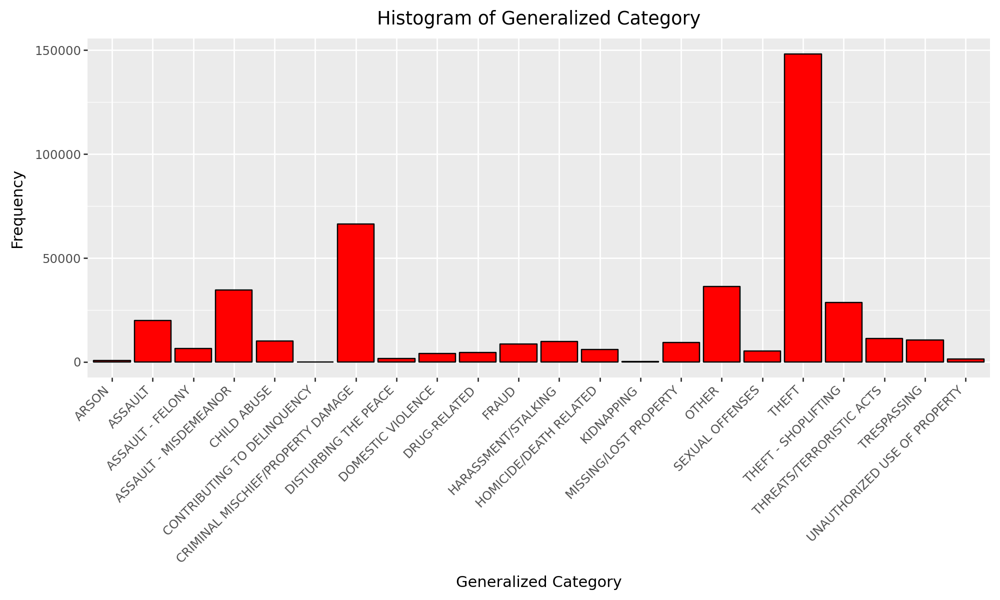

In [14]:
plot = (ggplot(data, aes(x='Generalized Category')) +
        geom_histogram(stat="count", fill="red", color="black") +  
        theme(axis_text_x=element_text(rotation=45, hjust=1),  
              figure_size=(10, 6)) + 
        labs(title='Histogram of Generalized Category', x='Generalized Category', y='Frequency'))
plot.show()

**Distribution of Crime Categories**

In [15]:
color_sequence = ["#800026", "#BD0026", "#E31A1C", "#FC4E2A", "#FD8D3C", "#FEB24C", "#FED976", "#FFEDA0", "#FFFFCC"]
# Create the pie chart with the defined color sequence
fig = px.pie(data, names='Generalized Category', title='Distribution of Crime Categories',
             color_discrete_sequence=color_sequence)
# Update the traces for better text formatting inside the slices
fig.update_traces(textposition='inside', textinfo='percent+label')

# Update the layout to increase the size of the figure
fig.update_layout(
    height=700,  # Height of the figure in pixels
    width=900,  # Width of the figure in pixels
    title_font_size=20,  # Title font size
    title_x=0.5,
    font=dict(size=10)  # Font size for labels and legend
)
# Show the figure
fig.show()

### Incident Type Distribution

The pie chart illustrates the distribution of various incident types reported. The most prominent categories are as follows:

- **Theft**: Constituting the majority, with 34.9% of the total incidents.
- **Criminal Mischief/Property Damage**: The second most frequent category, accounting for 15.6%.
- **Other**: A diverse category, making up 8.58%.
- **Assault - Misdemeanor**: Representing 8.15% of incidents.
- **Theft - Shoplifting**: Comprising 6.12%.
- **Assault**: At 4.73%.

The remaining categories each make up a smaller percentage of the total incidents, including but not limited to threats/terroristic acts, trespassing, child abuse, and harassment/stalking. The least common incidents reported are arson, kidnapping, and contributing to delinquency.

This distribution highlights the prevalence of theft-related incidents, suggesting a focus area for crime prevention efforts. It also reflects a significant proportion of incidents related to property damage and assault, indicating areas where community resources and law enforcement interventions might be directed to mitigate these occurrences.


**Distribution of Occurred District**

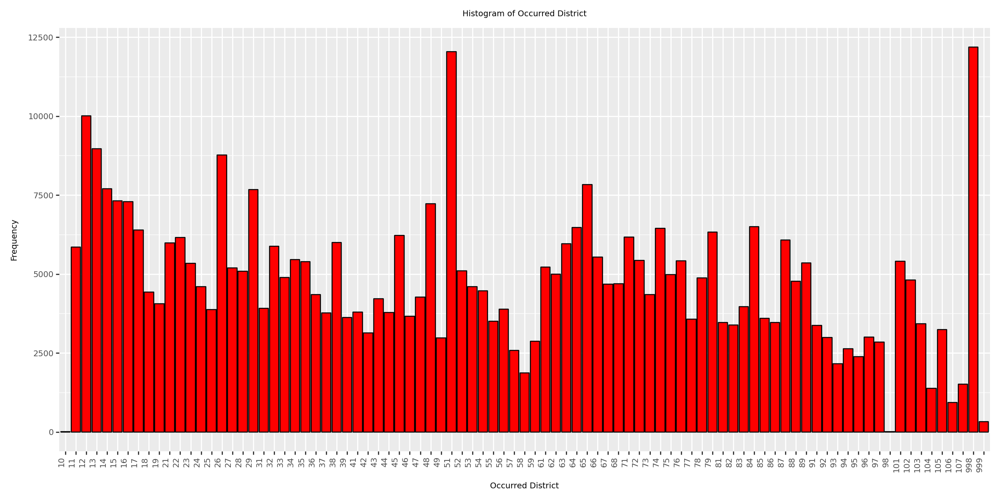

In [16]:
plot_width = 20  
plot_height = 15
label_size = 11 
data['Occurred District'] = pd.Categorical(data['Occurred District'])

# Calculate counts for each 'Occurred District' and sort
district_counts = data['Occurred District'].value_counts().sort_index()
sorted_districts = district_counts.index.tolist()

# Create a sorted bar chart using plotnine
plot = (ggplot(data, aes(x='Occurred District')) +
        geom_bar(aes(y='..count..'), fill="red", color="black") +
        theme(axis_text_x=element_text(rotation=90, hjust=1),  # Rotate x-axis labels for readability
              figure_size=(12, 6),  # Adjust figure size as needed
              text=element_text(size=7)) +  # Adjust text size as needed
        labs(title='Histogram of Occurred District', x='Occurred District', y='Frequency') +
        scale_x_discrete(limits=sorted_districts)  # Sort the x-axis categories
)
# Display the plot
plot.show()

#### Histogram of Incidents by Occurred District

The histogram illustrates the distribution of incidents across different districts. Each bar represents the frequency of incidents within a specific district, as indicated by the district number on the x-axis.

Observations:
- The frequency of incidents varies significantly from one district to another.
- Certain districts, notably those corresponding to the highest bars, exhibit a particularly high number of incidents, suggesting these are hotspots for activity.
- Conversely, some districts have relatively few incidents, which could indicate less activity or better deterrence and control mechanisms.
- There are noticeable spikes in frequency for some districts, which might be due to specific socio-economic factors, population density, or other regional characteristics that could influence the rate of incidents.

This distribution can be used to allocate resources more effectively, target preventive measures, and guide policy decisions to address high-incidence areas.


**Seasonal Analysis**

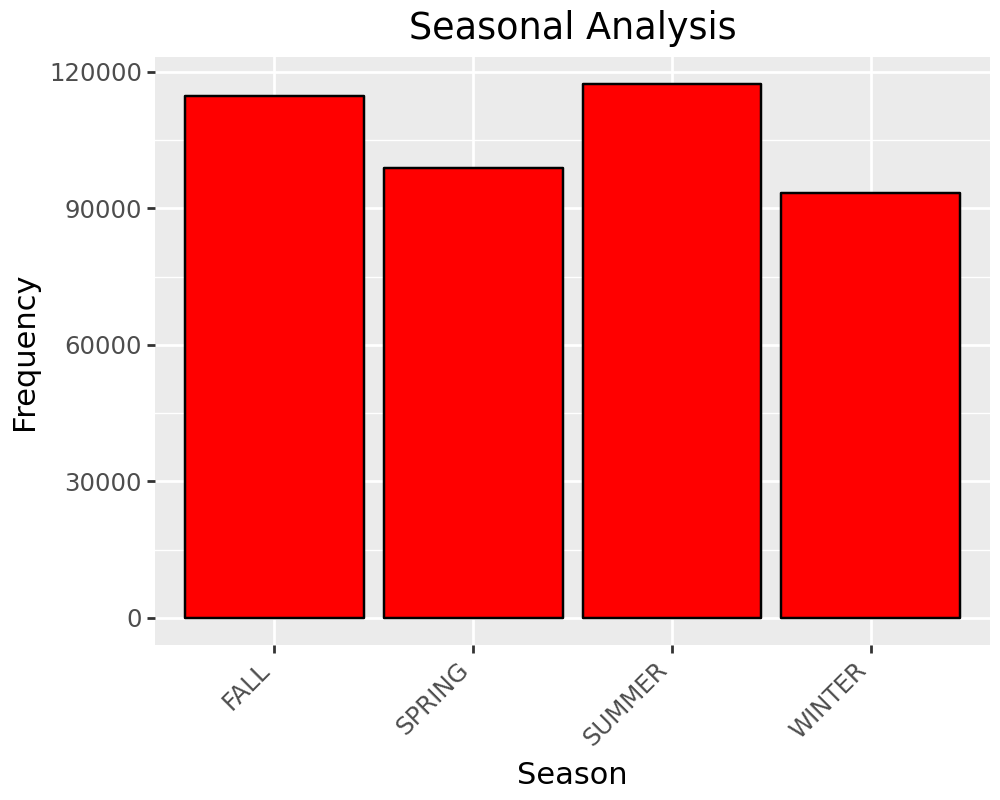

In [17]:
# Count incidents by season
width_in_inches = 5
height_in_inches = 4

plot = (ggplot(data, aes(x='Season')) +
        geom_bar(stat="count", fill="red", color="black") +
        theme(axis_text_x=element_text(rotation=45, hjust=1),
              figure_size=(width_in_inches, height_in_inches)) +  
        labs(title='Seasonal Analysis', x='Season', y='Frequency'))

# Display the plot
plot.show()

### Distribution of Incidents by Season

This histogram presents the frequency of incidents categorized under a 'Generalized Category' across different seasons: Fall, Spring, Summer, and Winter.

Observations:
- The number of incidents reported in each season is relatively similar, indicating a somewhat uniform distribution of incidents throughout the year.
- The Summer season exhibits a slightly higher frequency of incidents compared to other seasons, which might be due to various factors such as increased outdoor activities.
- The Spring season shows a marginally lower frequency, though not significantly distinct from Fall and Winter.

This information could be pivotal for planning seasonal law enforcement strategies and public safety campaigns, considering the slight increase in incidents during the warmer months.


### Now, use this new 'Hour' column for the pivot table

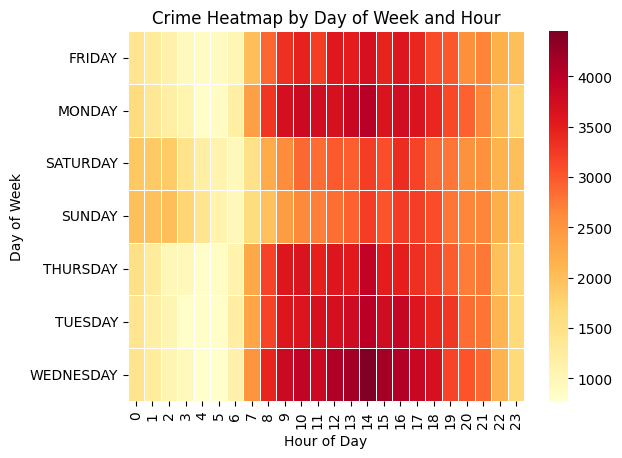

In [18]:
pivot_table = data.pivot_table(values='RB Number', index='DayOfWeekName', columns='Hour', aggfunc='count')

# Plotting the heatmap
sns.heatmap(pivot_table, cmap='YlOrRd', linewidths=.5)
plt.title('Crime Heatmap by Day of Week and Hour')
plt.ylabel('Day of Week')
plt.xlabel('Hour of Day')
plt.show()

### Crime Heatmap by Day of Week and Hour

This heatmap provides a visual representation of crime frequency broken down by the day of the week and hour of the day.

Observations:
- Higher crime rates are observed during the later hours of the day, particularly from late afternoon to midnight. This pattern is consistent across all days of the week.
- The intensity of colors on the heatmap indicates that the lowest frequency of crimes tends to occur in the early morning hours, around 0 to 4 AM.
- Friday and Saturday nights show a notably higher frequency of crimes, which may correlate with increased social activities during these times.
- Midweek days such as Tuesday and Wednesday show a more uniform distribution of crime throughout the day, with a slight increase in the evening hours.

The trends highlighted by this heatmap could be instrumental for law enforcement to allocate resources more effectively and increase patrols during peak crime hours, especially on weekends.


### Creating a Simple Map Focused on Omaha Using Sample Data

In [19]:
omaha_map = folium.Map(location=[41.2565, -95.9345], zoom_start=12)

# Add a marker for each incident (sample a subset if the dataset is large)
for idx, row in data.sample(10000).iterrows():
    folium.CircleMarker(location=[row['Occurred Block LAT'], row['Occurred Block LON']],
                        radius=5,
                        color='red',
                        fill=True).add_to(omaha_map)

In [20]:
omaha_map

### Monthly Crime Trends by Category

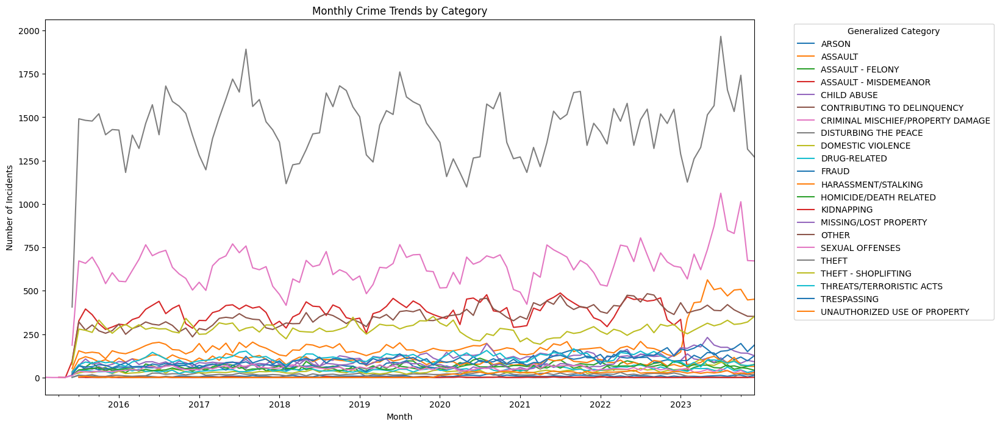

In [21]:
# Convert 'Reported Date' to datetime 
data['Reported Date'] = pd.to_datetime(data['Reported Date'])

# Set the 'Reported Date' as the index
data.set_index('Reported Date', inplace=True)

# Group by 'Generalized Category' and resample to get monthly counts
monthly_crime_trends = data.groupby('Generalized Category').resample('ME').size()

# Reset the index so that 'Generalized Category' and 'Reported Date' are columns again
monthly_crime_trends = monthly_crime_trends.reset_index(name='Counts')

# Pivot the data to have categories as columns and dates as rows
pivot_table = monthly_crime_trends.pivot(index='Reported Date', columns='Generalized Category', values='Counts')

# Plotting
fig, ax = plt.subplots(figsize=(15, 8))
pivot_table.plot(ax=ax)
plt.title('Monthly Crime Trends by Category')
plt.xlabel('Month')
plt.ylabel('Number of Incidents')
plt.legend(title='Generalized Category', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()


###  Monthly Crime Trends by Category

The visualization presents an overview of the monthly crime trends categorized by the type of incident reported. Each line in the plot corresponds to a different category, allowing us to observe the variation in incident reports over time for each crime type.

Key observations:
- The `Theft` category, shown in black, has the highest number of incidents reported almost every month, indicating it is the most common crime.
- Some categories, like `Assault - Misdemeanor` and `Criminal Mischief/Property Damage`, also show significant monthly fluctuations, suggesting seasonal or other underlying factors affecting these trends.
- Other categories, such as `Domestic Violence` and `Drug-Related` incidents, maintain a relatively steady occurrence throughout the years, hinting at consistent reporting rates month-to-month.
- The less frequent crimes, like `Arson` and `Kidnapping`, are represented by lines closer to the bottom of the plot, demonstrating their rarity in comparison to other crimes.

Overall, the plot reveals that while some types of crimes have pronounced peaks and troughs possibly linked to specific times of the year, others remain relatively constant. This information could be invaluable for law enforcement and public policy makers to allocate resources more effectively and to implement targeted crime prevention strategies.



###  Crime Counts per Year by Category

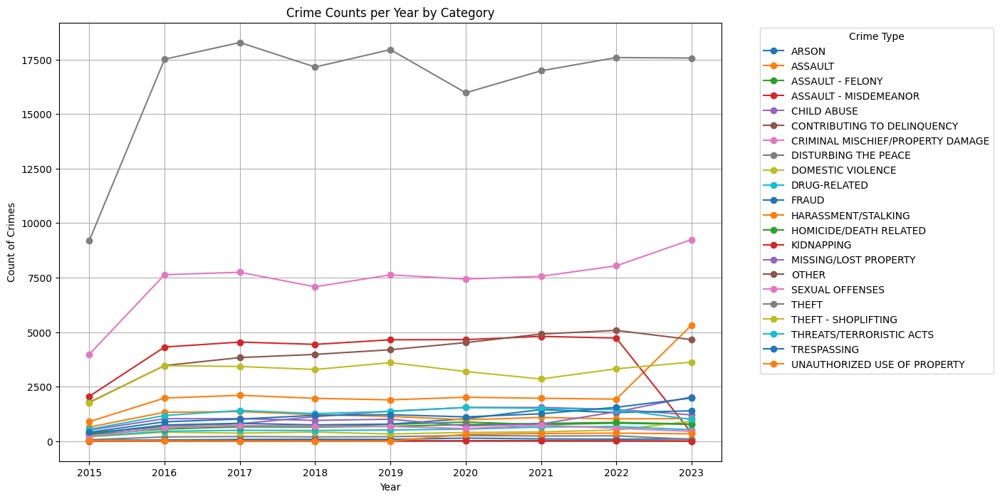

In [22]:
# Group data by year and 'Generalized Category', then count the occurrences
yearly_category_data = data.groupby(['Year', 'Generalized Category']).size().unstack(fill_value=0)

# Plot the time series data for each crime type
plt.figure(figsize=(12, 8))
for category in yearly_category_data.columns:
    plt.plot(yearly_category_data.index, yearly_category_data[category], marker='o', linestyle='-', label=category)

plt.title('Crime Counts per Year by Category')
plt.xlabel('Year')
plt.ylabel('Count of Crimes')
plt.legend(title='Crime Type', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()

#### Crime Counts per Year by Category

The line chart depicts the annual crime counts across various categories over several years.

Observations:
- The category with the consistently highest crime count is 'THEFT,' with peaks and troughs over the years but maintaining a prominent position throughout.
- 'ASSAULT - MISDEMEANOR' shows a relatively stable trend with a slight increase in recent years.
- Notably, 'CRIMINAL MISCHIEF/PROPERTY DAMAGE' demonstrates a significant increase in crime counts, particularly in the most recent year shown.
- Categories such as 'ARSON,' 'KIDNAPPING,' and 'HOMICIDE/DEATH RELATED' maintain lower frequencies compared to others but are essential to monitor for any changes in trends.
- The overall trend for most crime categories appears relatively stable, with some fluctuation but no drastic increases or decreases in frequency.

This visualization can help law enforcement and public safety officials monitor trends in crime, identify categories that require increased attention, and evaluate the effectiveness of crime prevention strategies over time.


### Probability Mass Function (PMF) of Incidents by Weekend vs. Weekday¶

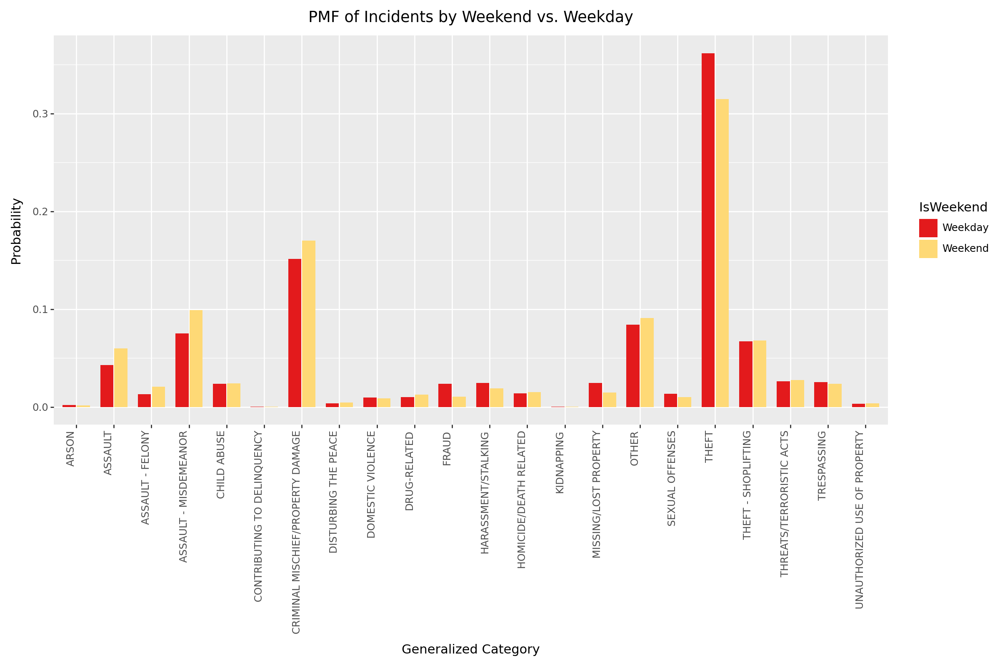

In [23]:
# Create a new DataFrame for counts
count_df = data.groupby(['IsWeekend', 'Generalized Category']).size().reset_index(name='counts')

# Calculate the total counts for weekend and weekday
weekend_total = count_df[count_df['IsWeekend'] == True]['counts'].sum()
weekday_total = count_df[count_df['IsWeekend'] == False]['counts'].sum()

# Calculate proportions
count_df['proportion'] = count_df.apply(
    lambda row: row['counts'] / weekend_total if row['IsWeekend'] else row['counts'] / weekday_total, axis=1
)

# Convert the 'IsWeekend' column to a string for clearer category labels
count_df['IsWeekend'] = count_df['IsWeekend'].map({True: 'Weekend', False: 'Weekday'})

# Define a color palette similar to 'YlOrRd'
yellow_orange_red_palette = ["#E31A1C", "#FED976",]  # Simplified for two categories

# Create the plot with the specified color palette
plot = (ggplot(count_df, aes(x='Generalized Category', y='proportion', fill='IsWeekend')) +
        geom_bar(stat='identity', position=position_dodge(width=0.75), width=0.7) +
        scale_fill_manual(values=yellow_orange_red_palette) +
        labs(x='Generalized Category', y='Probability', title='PMF of Incidents by Weekend vs. Weekday') +
        theme(axis_text_x=element_text(rotation=90, hjust=1),
              figure_size=(12, 8))
        )

# Display the plot
plot.show()

### Probability Mass Function (PMF) of Incidents by Weekend vs. Weekday

This PMF plot provides a comparative view of the probability of different types of incidents occurring on weekends versus weekdays. Each bar represents the proportion of total incidents that fall into a specific category, allowing us to observe patterns that differ between these two time frames.

Key observations from the plot:
- The most striking difference is seen in the `Theft` category, which has a noticeably higher probability of occurrence on weekdays than on weekends.
- Categories such as `Theft - Shoplifting` and `Threats/Terroristic Acts` also show a higher prevalence during the weekdays.
- In contrast, incidents categorized as `Assault - Misdemeanor` and `Domestic Violence` appear to have a slightly higher probability of occurrence on weekends.
- The `Other` category, which might encompass various incident types, shows a significant presence on weekends, suggesting a variety of incidents tend to be reported during that time.

Overall, the PMF plot reveals distinct patterns in incident reporting between weekends and weekdays, which could imply differences in social behavior, policing, or reporting practices. This insight is valuable for law enforcement agencies to tailor their operational strategies accordingly.


### Cumulative Distribution Function (CDF) of Incidents Over Years

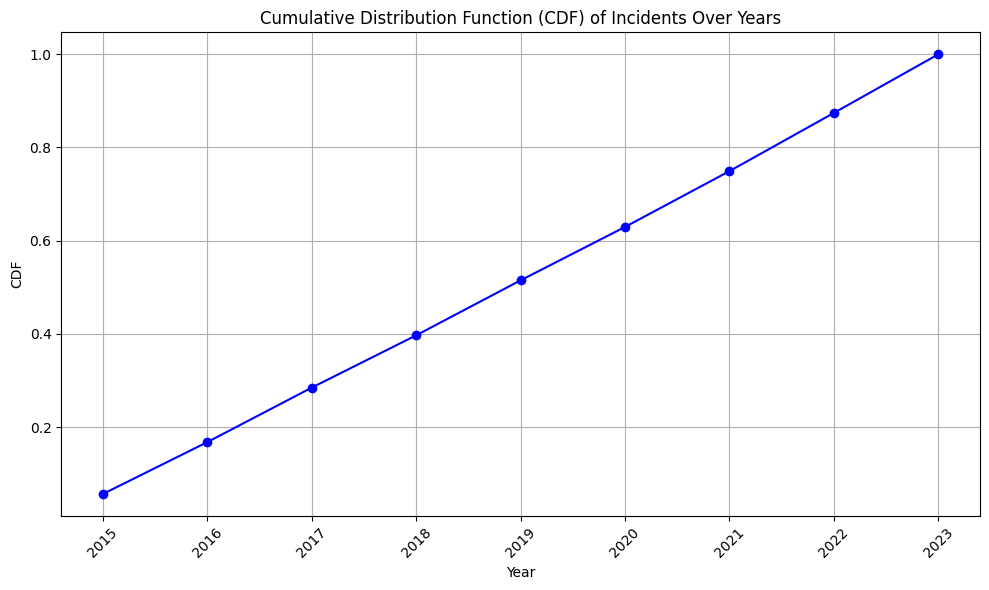

In [24]:
# Calculate the CDF for the 'Year' variable
year_counts = data['Year'].value_counts().sort_index()
cumulative_counts = np.cumsum(year_counts)
total_incidents = cumulative_counts.iloc[-1]
cdf = cumulative_counts / total_incidents

# Plot the CDF
plt.figure(figsize=(10, 6))
plt.plot(cdf.index, cdf, marker='o', linestyle='-', color='b')
plt.title('Cumulative Distribution Function (CDF) of Incidents Over Years')
plt.xlabel('Year')
plt.ylabel('CDF')
plt.grid(True)
plt.xticks(cdf.index, rotation=45)  # Rotate x-axis labels for better readability
plt.tight_layout()  # Adjust layout to make room for the rotated x-axis labels

plt.show()

#### Cumulative Distribution Function (CDF) of Incidents Over Years

The graph presents the CDF of reported incidents over the years, starting from 2015 up to 2023.

Observations:
- There is a steady and linear increase in the cumulative proportion of incidents over the years.
- Each point on the curve represents the total proportion of incidents that have occurred up to the end of a given year.
- The even progression of the curve suggests a consistent rate of incident reporting over time without any significant fluctuations or deviations.
- By 2023, the CDF reaches 1, indicating that all incidents recorded in the dataset have been accounted for up to that year.

This CDF provides insights into the accumulation of incidents over time and can help in understanding long-term trends, whether there is an increase or stability in the rate of incidents, and potentially in planning for future public safety and law enforcement resource allocation.


### Distribution of Incidents per District vs. Poisson Distribution

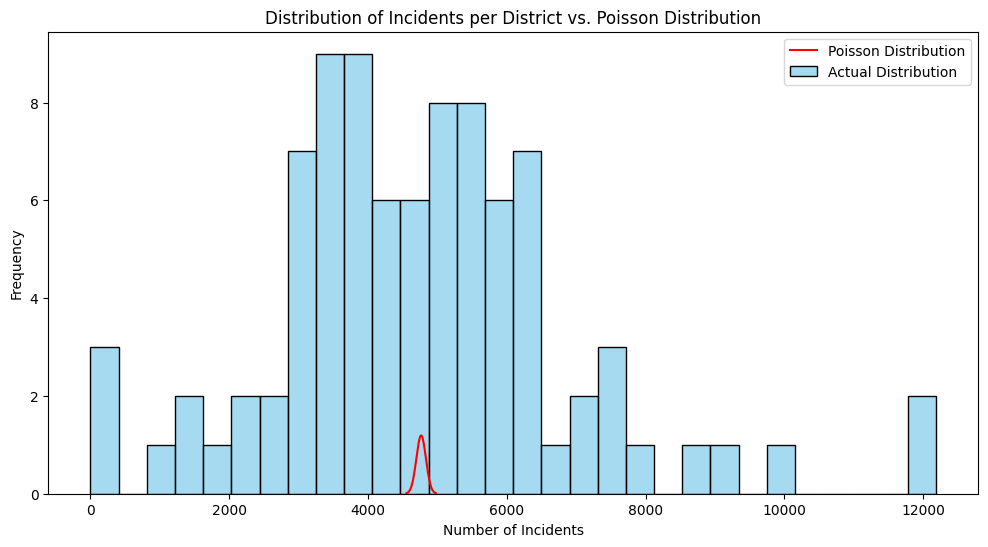

In [25]:
district_counts = data['Occurred District'].value_counts()
mean_incidents_per_district = district_counts.mean()

# Generate Poisson distribution based on the mean
poisson_dist = poisson(mu=mean_incidents_per_district)
x = np.arange(poisson_dist.ppf(0.001), poisson_dist.ppf(0.999))

# Plot the actual distribution of incidents per district and the Poisson distribution
plt.figure(figsize=(12, 6))

# Actual distribution
sns.histplot(district_counts, bins=30, kde=False, label='Actual Distribution', color='skyblue')

# Poisson distribution
plt.plot(x, poisson_dist.pmf(x) * len(district_counts) * (max(district_counts.index) - min(district_counts.index)) / len(x), 'r-', ms=8, label='Poisson Distribution')

plt.title('Distribution of Incidents per District vs. Poisson Distribution')
plt.xlabel('Number of Incidents')
plt.ylabel('Frequency')
plt.legend()

plt.show()

### Mean number of incidents per district

In [26]:
# Output the mean for reference
print(f'Mean number of incidents per district: {mean_incidents_per_district}')

Mean number of incidents per district: 4767.033707865168


### Fit of Normal Distribution to Reported Hour

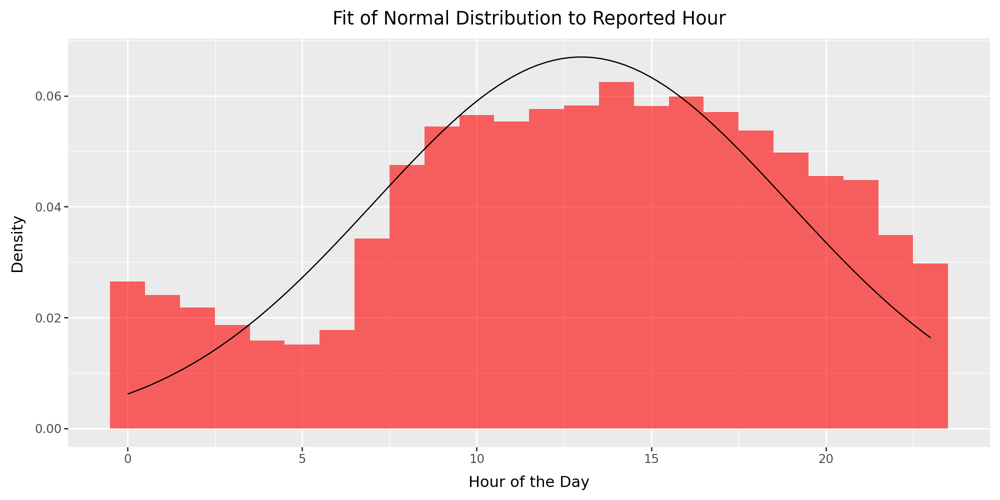

In [27]:
from plotnine import ggplot, aes, geom_histogram, geom_line, theme, labs, stat_function
from scipy.stats import norm
import pandas as pd

# Assuming 'data' is your DataFrame and 'Hour' is the column you want to analyze
# Ensure 'Hour' is a numerical column and drop NaN values
hour_data = data[['Hour']].dropna()  # Select 'Hour' as a DataFrame

# Fit a normal distribution to the 'Hour' column
mu, std = norm.fit(hour_data['Hour'])

# Create the ggplot object with the histogram
ggplot_obj = (ggplot(hour_data, aes(x='Hour')) 
              + geom_histogram(aes(y='stat(density)'), bins=24, fill='red', alpha=0.6) 
              + stat_function(fun=norm.pdf, args={'loc': mu, 'scale': std}, color='black')
              + labs(title='Fit of Normal Distribution to Reported Hour', x='Hour of the Day', y='Density')
              + theme(figure_size=(10, 5)))

# Display the plot
ggplot_obj


### Analysis of Reported Crimes by Hour

The histogram with a normal distribution overlay illustrates the density of reported crimes throughout different hours of the day. It is evident from the histogram that the frequency of crime reports is not uniform across the 24-hour cycle. There is a notable peak in crime reports in the evening, particularly around 18:00 (6 PM), suggesting that crimes are more frequently reported during this time.

The normal distribution curve, while providing a general sense of the data's central tendency, does not fit the observed distribution precisely. This discrepancy indicates that the actual distribution of crime reports has a skew, with a higher frequency in the late hours than would be expected in a perfectly normal distribution. This could be due to various social factors such as increased public activity in the evening or the timing of when people return home and notice or report crimes.

Given these observations, it is important for law enforcement agencies to consider these temporal patterns when allocating resources for crime prevention and response. The evening hours may require heightened vigilance and patrolling to address the higher crime reporting rate during this period.


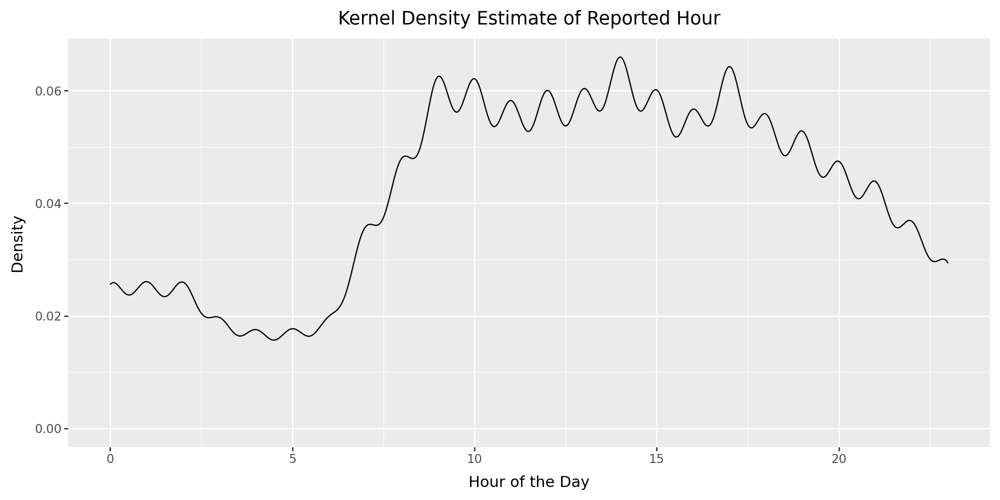

In [28]:
from plotnine import ggplot, aes, geom_density, theme, labs
import pandas as pd
import numpy as np

# Assuming 'data' is your DataFrame and 'Hour' is the column you want to analyze
# Reduce the dataset by taking a random sample of 10,000 rows (adjust the number as needed)
sampled_data = data.dropna(subset=['Hour']).sample(n=10000, random_state=1)

# Using ggplot from plotnine to create the KDE plot
ggplot_obj = (ggplot(sampled_data, aes(x='Hour')) +
              geom_density(aes(y='stat(density)'), adjust=0.5) +  # adjust acts like bw_adjust
              labs(title='Kernel Density Estimate of Reported Hour', x='Hour of the Day', y='Density') +
              theme(figure_size=(10, 5)))

# Display the plot
ggplot_obj


###  Interpretation of the Histogram with Normal Distribution Fit

The histogram with a normal distribution fit reveals the reported hours of crime do not follow a normal distribution. We observe that the crime reporting frequency is non-uniform, with significant variations throughout the day.

The bimodal nature of the histogram suggests two periods of high crime reporting frequency: one in the late evening and another around midday. This pattern may reflect societal behavior, where people are more active and thus more crimes are reported.

The fit of the normal distribution curve to the histogram data indicates that the actual distribution of reported crimes deviates from a theoretical normal distribution. The discrepancies between the histogram and the normal distribution curve highlight the presence of more complex patterns in crime reporting, which could be influenced by a variety of factors such as social activities, law enforcement presence, and the likelihood of witnesses being present.

Overall, the data suggests that crime reporting is influenced by the time of day, with certain hours being more prone to crime occurrences or the reporting of crimes. This analysis can inform law enforcement and public safety strategies to allocate resources effectively based on the time-of-day patterns in crime reporting.


### Scatter Plot of Incident Locations

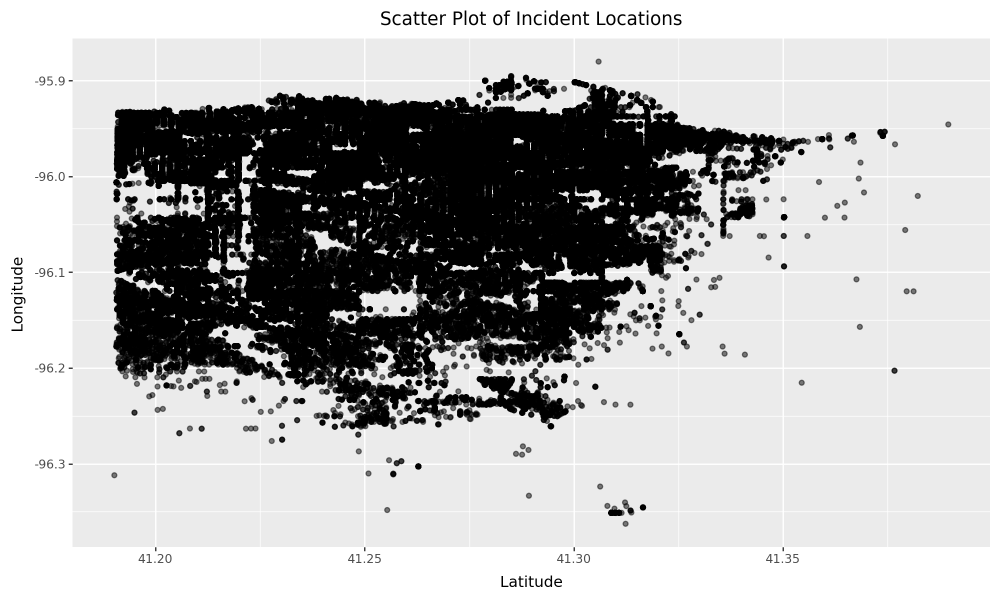

In [29]:
from plotnine import ggplot, aes, geom_point, labs, theme

# Assuming 'data' is your DataFrame
scatter_plot = (ggplot(data, aes(x='Occurred Block LAT', y='Occurred Block LON')) +
              geom_point(alpha=0.5) +
              labs(title='Scatter Plot of Incident Locations', x='Latitude', y='Longitude') +
              theme(figure_size=(10, 6)))

# Display the plot
scatter_plot


In [30]:
# Calculate the Pearson correlation coefficient between 'Occurred Block LAT' and 'Occurred Block LON'
correlation_coefficient = data[['Occurred Block LAT', 'Occurred Block LON']].corr().iloc[0, 1]

print(f"The Pearson correlation coefficient between latitude and longitude of incidents is: {correlation_coefficient}")


The Pearson correlation coefficient between latitude and longitude of incidents is: 0.05194555916222498


# Spatial Analysis of Crime Incidents

This repository contains data and analysis scripts for exploring the spatial distribution of crime incidents. The primary objective is to understand the geographical patterns of crime occurrences and identify any potential hotspots or areas of interest.

## Dataset Overview

The dataset includes various details about crime incidents, such as the report number, reported date and time, location (latitude and longitude), generalized category of the crime, and additional temporal information. The key columns used in the spatial analysis include:

- `Occurred Block LAT`: Latitude of the incident location.
- `Occurred Block LON`: Longitude of the incident location.
- `Generalized Category`: Broad category of the reported incident.

## Analysis 

### Correlation Analysis

A Pearson correlation analysis was conducted to explore the linear relationship between the latitude (`Occurred Block LAT`) and longitude (`Occurred Block LON`) of reported incidents. The correlation coefficient obtained was approximately 0.052, indicating a very weak linear relationship between the two geographical coordinates.

#### Interpretation

The minimal correlation coefficient suggests that there is no significant linear association between the latitude and longitude of incidents. This outcome is expected, as these coordinates simply represent spatial locations and do not inherently possess a linear relationship in the context of crime incidents.

#### Implications for Analysis

The absence of a strong correlation between latitude and longitude emphasizes the complexity of spatial data and the necessity for employing geographic information system (GIS) tools or spatial analysis techniques to uncover meaningful patterns. Advanced spatial analysis methods or visual exploration through maps and scatter plots are essential for a comprehensive understanding of the geographical distribution of crime.

### Summary

The spatial analysis of crime incidents, based on the Pearson correlation coefficient between latitude and longitude, confirms the lack of a linear relationship between these spatial dimensions. For detailed insights and to identify crime hotspots, further spatial analysis and visualization techniques are recommended.

#### Heatmap of Incident Types by Day of the Week

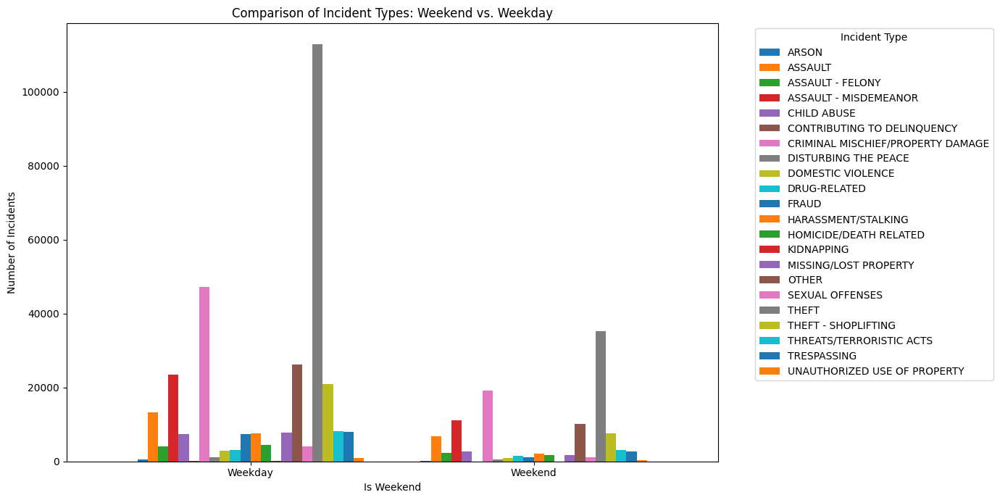

In [31]:

# Weekend vs. Weekday Analysis
# Aggregate incidents by weekend/weekday
weekend_weekday_comparison = data.groupby('IsWeekend')['Generalized Category'].value_counts().unstack(fill_value=0)

# Plotting the comparison
weekend_weekday_comparison.plot(kind='bar', figsize=(14, 7), width=0.8)
plt.title('Comparison of Incident Types: Weekend vs. Weekday')
plt.xlabel('Is Weekend')
plt.ylabel('Number of Incidents')
plt.xticks(ticks=[0, 1], labels=['Weekday', 'Weekend'], rotation=0)
plt.legend(title='Incident Type', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

### Comparison of Incident Types: Weekend vs. Weekday

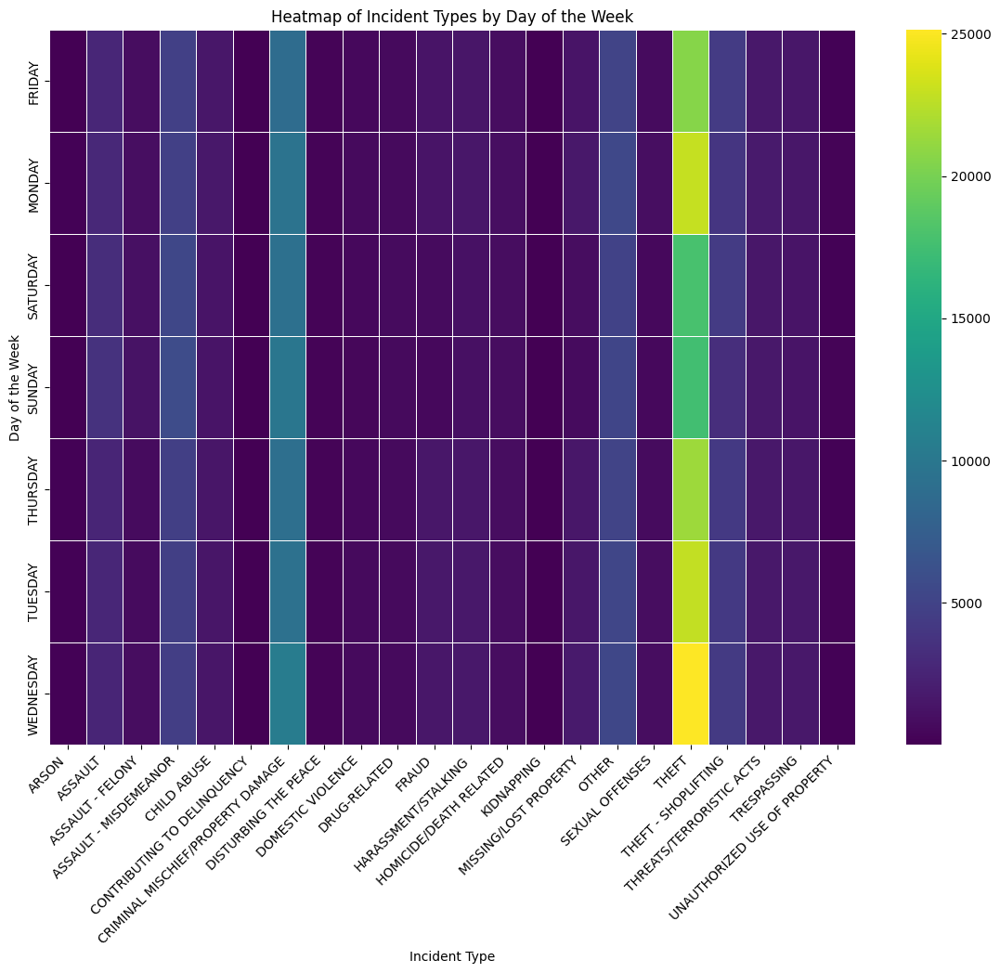

In [32]:
contingency_table = pd.crosstab(data['DayOfWeekName'], data['Generalized Category'])

# Plotting th`ae heatmap
plt.figure(figsize=(14, 10))
sns.heatmap(contingency_table, cmap='viridis', annot=False, linewidths=.5)
plt.title('Heatmap of Incident Types by Day of the Week')
plt.xlabel('Incident Type')
plt.ylabel('Day of the Week')
plt.xticks(rotation=45, ha='right')
plt.show()

### Distribution of Incidents per District vs. Poisson Distribution

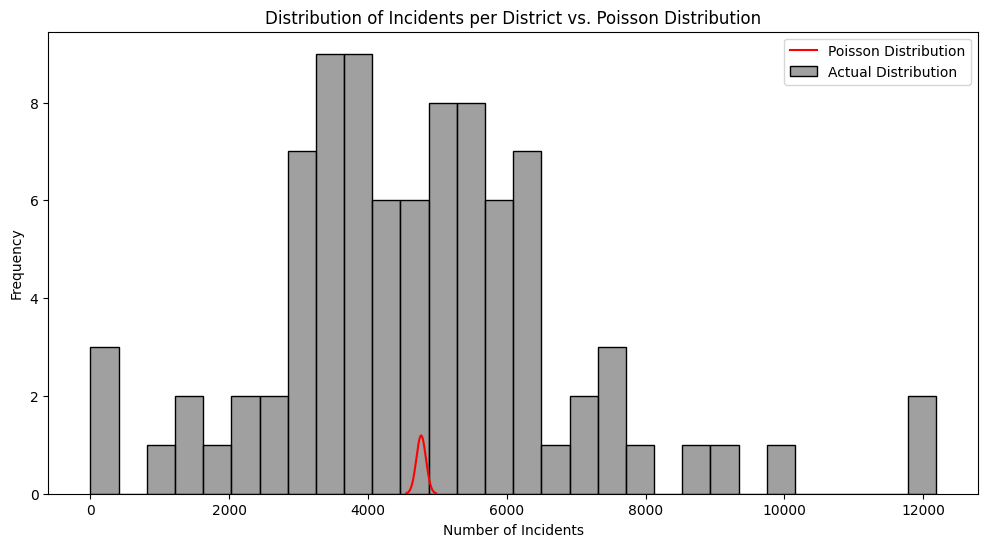

4767.033707865168

In [33]:
# Calculate the mean number of incidents per district
district_counts = data['Occurred District'].value_counts()
mean_incidents_per_district = district_counts.mean()

# Generate Poisson distribution based on the mean
poisson_dist = poisson(mu=mean_incidents_per_district)
x = np.arange(poisson_dist.ppf(0.001), poisson_dist.ppf(0.999))

# Plot the actual distribution of incidents per district and the Poisson distribution
plt.figure(figsize=(12, 6))

# Actual distribution
sns.histplot(district_counts, bins=30, kde=False, label='Actual Distribution', color='gray')

# Poisson distribution
plt.plot(x, poisson_dist.pmf(x) * len(district_counts) * (max(district_counts.index) - min(district_counts.index)) / len(x), 'r-', ms=8, label='Poisson Distribution')

plt.title('Distribution of Incidents per District vs. Poisson Distribution')
plt.xlabel('Number of Incidents')
plt.ylabel('Frequency')
plt.legend()

plt.show()

# Output the mean for reference
mean_incidents_per_district

### Analysis of Fit of Normal Distribution to Reported Hour

The histogram overlaid with the normal distribution curve suggests that the reported hours of crime are not normally distributed. There is a noticeable skew towards the later hours of the day, indicating that crimes are more frequently reported during the evening.

### Analysis of Kernel Density Estimate of Reported Hour

The KDE plot reveals a multimodal distribution with peaks at around 10 am and again at 8 pm. This could reflect patterns in social behavior, such as increased activity during morning commute hours and evening leisure time, which may influence when crimes are reported.

### Analysis of Distribution of Incidents per District vs. Poisson Distribution

Comparing the actual distribution of incidents with the Poisson distribution highlights significant discrepancies, particularly in districts with very high or very low incident counts. This suggests that the assumption of a Poisson process may not be fully applicable to this data, and other factors could be influencing incident rates across districts.


### Define the null and alternative hypotheses

- null_hypothesis = "There is no difference in the rate of incidents between weekends and weekdays."
- alternative_hypothesis = "The rate of incidents on weekends is higher than on weekdays."

## Hypothesis Testing Results: Reported Hour of Crime

In [34]:
from scipy.stats import ttest_ind

# Assuming 'data' is your DataFrame and it contains 'Hour' and 'IsWeekend' columns
weekend_hours = data[data['IsWeekend'] == True]['Hour']
weekday_hours = data[data['IsWeekend'] == False]['Hour']

# Conduct the t-test
t_stat, p_value = ttest_ind(weekend_hours, weekday_hours, nan_policy='omit')

# Print the results
print(f"T-statistic: {t_stat}")
print(f"P-value: {p_value}")

# Decision
alpha = 0.05
if p_value < alpha:
    print("Reject the null hypothesis - There is a significant difference in the mean reported hour of crime between weekends and weekdays.")
else:
    print("Fail to reject the null hypothesis - There is no significant difference in the mean reported hour of crime between weekends and weekdays.")


T-statistic: -20.40674125347716
P-value: 1.6142191155932547e-92
Reject the null hypothesis - There is a significant difference in the mean reported hour of crime between weekends and weekdays.


#### Hypothesis Testing Results: Reported Hour of Crime

#### Objective

The goal was to determine whether there is a statistically significant difference in the mean reported hour of crime between weekends and weekdays.

#### Methodology

An independent samples t-test was conducted comparing the mean reported hour of crime on weekends versus weekdays.

#### Results

- **T-statistic**: -20.41
- **P-value**: 1.61e-92

#### Decision

Given the extremely low P-value, which is significantly below the commonly used significance level (α = 0.05), we **reject the null hypothesis**. 

#### Interpretation

This indicates that there is a **significant difference** in the mean reported hour of crime between weekends and weekdays. The negative T-statistic suggests that crimes on weekends are reported at different hours compared to weekdays.

#### Implications

This finding may reflect differences in social behavior or activities between weekdays and weekends, influencing when crimes occur or are detected. For law enforcement and public safety planning, these insights could inform targeted strategies for patrolling or resource allocation at times when crime reporting is more prevalent.

#### Conclusion

The statistical analysis provides clear evidence of a variation in crime reporting times between weekends and weekdays. Understanding these patterns is crucial for effective public safety measures and crime prevention strategies. Further research could explore the specific types of crimes that contribute to this difference or examine other factors that might influence reporting times.


In [35]:
import statsmodels.api as sm

# Prepare the data
# Group the data by "Occurred District" and count the number of incidents in each district
district_counts = data['Occurred District'].value_counts()

# Create a dataframe with "Occurred District" as the index and incident counts as the column
district_counts_df = pd.DataFrame({'District': district_counts.index, 'Incident_Count': district_counts.values})

# Set "Occurred District" as the independent variable (X) and incident counts as the dependent variable (y)
X = district_counts_df['District']  
y = district_counts_df['Incident_Count']  

# Add a constant to the independent variable for the intercept term
X = sm.add_constant(X)

# Fit the regression model
model = sm.OLS(y, X).fit()

# Print the regression results
print(model.summary())


                            OLS Regression Results                            
Dep. Variable:         Incident_Count   R-squared:                       0.001
Model:                            OLS   Adj. R-squared:                 -0.011
Method:                 Least Squares   F-statistic:                   0.04478
Date:                Sat, 02 Mar 2024   Prob (F-statistic):              0.833
Time:                        19:49:39   Log-Likelihood:                -810.55
No. Observations:                  89   AIC:                             1625.
Df Residuals:                      87   BIC:                             1630.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const       4739.5651    267.623     17.710      0.0

### OLS Regression Analysis

#### Code Explanation

The regression analysis begins by importing the `statsmodels.api` module. The data is then grouped by the 'Occurred District' to count the number of incidents within each district. A new DataFrame is created with 'Occurred District' as the index and the incident counts as a column.

An OLS regression model is then specified, with the district number as the independent variable and the incident counts as the dependent variable. A constant is added to the model to account for the intercept.

#### Regression Results

- **Dependent Variable**: Incident_Count
- **R-squared**: 0.001
- **Adjusted R-squared**: -0.011
- **p-value (District)**: 0.833

The regression results indicate that the model does not explain the variability in the incident counts well, as evidenced by an R-squared value close to zero. The p-value associated with the 'District' coefficient is well above the typical significance level of 0.05, suggesting that there is no statistical evidence of a linear relationship between the district number and the number of incidents.

The model's F-statistic and its associated p-value also indicate that the model is not statistically significant.

#### Diagnostic Tests

- **Omnibus (p-value)**: 0.002 - Indicates the residuals are not normally distributed.
- **Durbin-Watson**: 0.020 - Suggests potential autocorrelation in the residuals.
- **Jarque-Bera (JB) (p-value)**: 0.000237 - Also indicates that the residuals do not follow a normal distribution.
- **Condition Number**: 186 - A high condition number could indicate multicollinearity, although in this context, it more likely reflects the scale of the 'District' variable.

#### Conclusions

The regression analysis does not provide a good fit for the data, and the number of incidents does not appear to be related to the district number in a linear fashion. The diagnostics suggest issues with the normality of residuals and potential autocorrelation. This may be due to the nature of crime incidents, which are not likely to be evenly distributed across districts due to a variety of socio-economic and geographical factors. A more complex model or a different analytical approach may be necessary to accurately model the number of incidents.


# <center>  $\color{indigo}{\text{ Thank you!. }}$ </center>